<a href="https://colab.research.google.com/github/bharadwaj-nidumolu/CS-682-AI_Animal_Gate_Way/blob/main/Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

***Installing Detectron***

In [74]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  Using cached PyYAML-5.1.tar.gz (274 kB)
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
fatal: destination path 'detectron2' already exists and is not an empty directory.


In [75]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.1 ; cuda:  cu118
detectron2: 0.6


In [76]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
import time

In [77]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


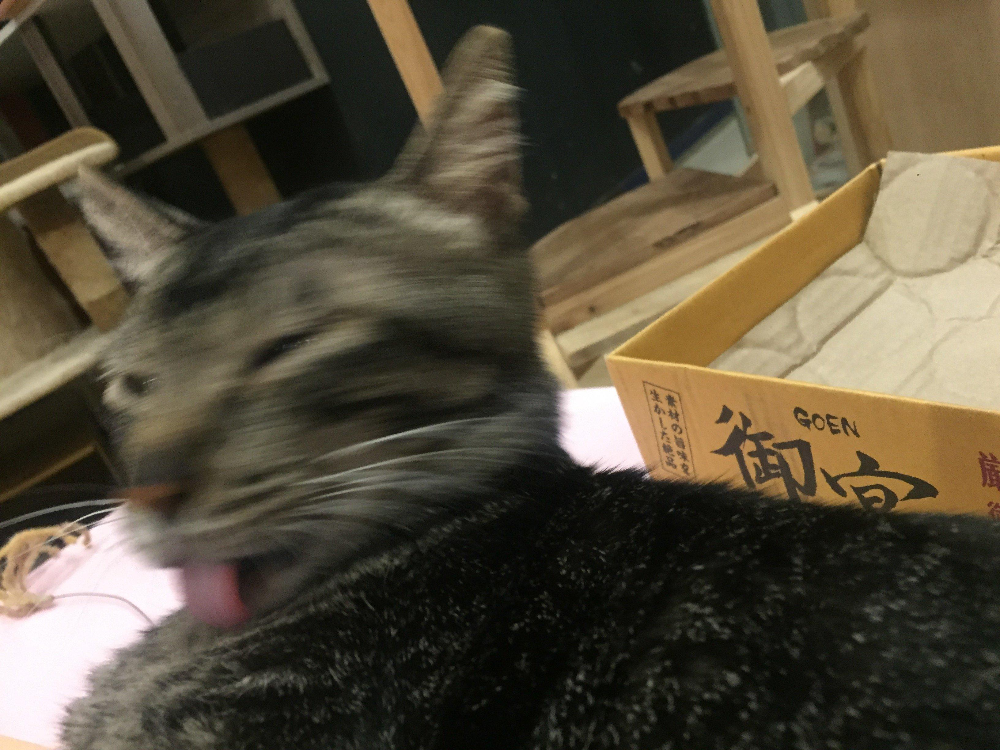

In [78]:
cat_image = cv2.imread("/content/drive/MyDrive/dataSamples/0011_000.jpeg")
cv2_imshow(cat_image)

In [79]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.DEVICE = "cpu"
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
start_time = time.time()
outputs_cat = predictor(cat_image)
end_time = time.time()
prediction_time  = end_time - start_time
print("Prediction time: {:.4f} seconds".format(prediction_time))

[10/22 13:07:45 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
Prediction time: 12.4815 seconds


***Here our prediction time is : 7.9685 sec***

In [80]:
print(outputs_cat["instances"].pred_classes)
print(outputs_cat["instances"].pred_boxes)

tensor([56, 15, 59])
Boxes(tensor([[1974.6138,    8.0406, 2902.3948,  647.2274],
        [ 267.8981,   58.1301, 3021.7085, 2430.8438],
        [1975.7898,  473.6114, 3264.0000, 1696.6571]]))


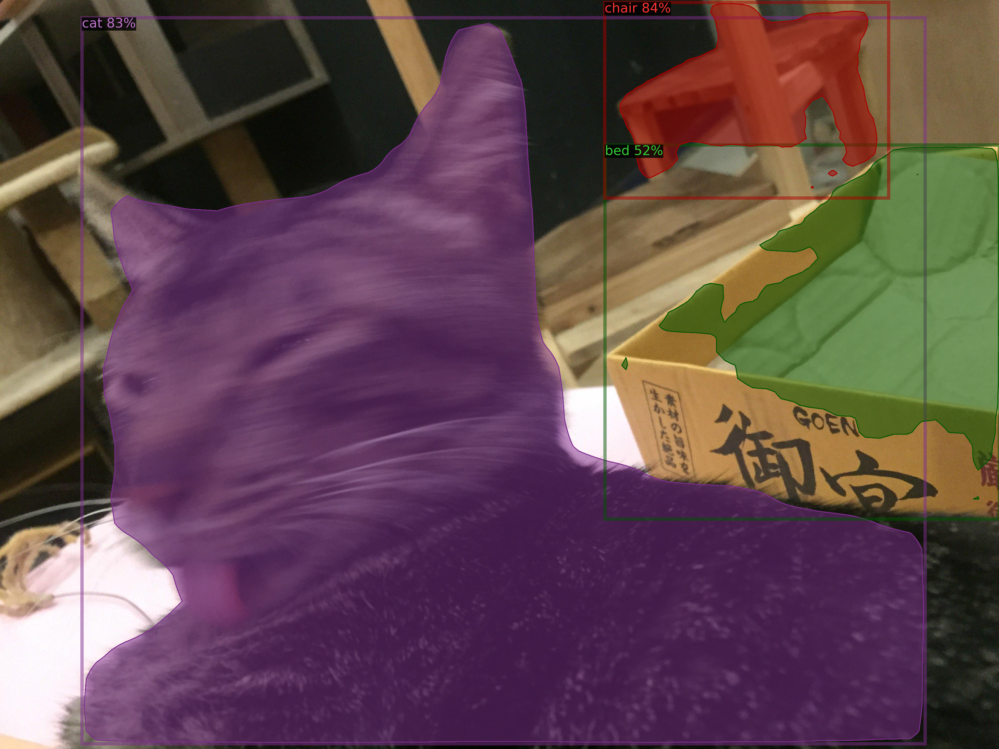

In [81]:
# We can use `Visualizer` to draw the predictions on the image.
v = Visualizer(cat_image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out_1 = v.draw_instance_predictions(outputs_cat["instances"].to("cpu"))
cv2_imshow(out_1.get_image()[:, :, ::-1])

In [82]:
# Get the predicted classes
predicted_classes = outputs_cat["instances"].pred_classes

# Define the class ID you want to filter for (e.g., "cat" class)
# From above tensor([56, 15, 59]) we can notice we 3 classes : 56,15,59
# After checking one-to-one , our cat class_id is 15
cat_class_id = 15

# Filter instances belonging to the 'cat' class
cat_instances = outputs_cat["instances"][predicted_classes == cat_class_id]


In [83]:
cat_instances

Instances(num_instances=1, image_height=2448, image_width=3264, fields=[pred_boxes: Boxes(tensor([[ 267.8981,   58.1301, 3021.7085, 2430.8438]])), scores: tensor([0.8313]), pred_classes: tensor([15]), pred_masks: tensor([[[False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         ...,
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False],
         [False, False, False,  ..., False, False, False]]])])

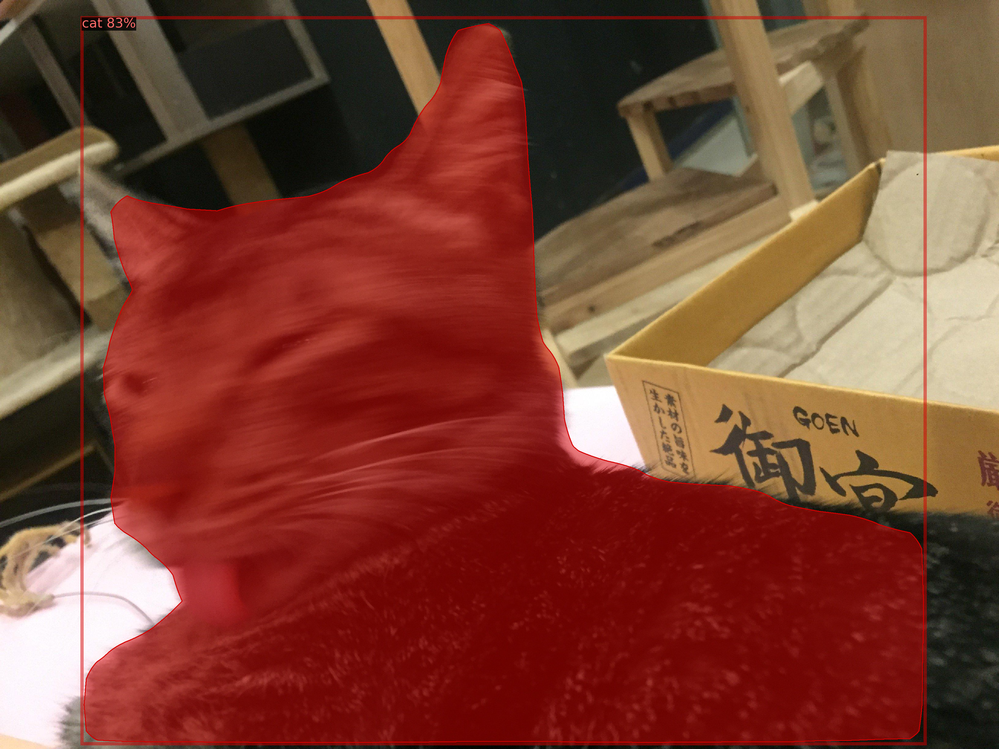

In [84]:
v = Visualizer(cat_image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out_1 = v.draw_instance_predictions(cat_instances.to("cpu"))
cv2_imshow(out_1.get_image()[:, :, ::-1])

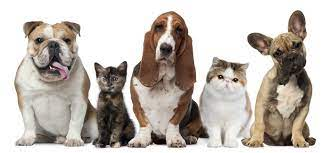

In [85]:
cat_dog = cv2.imread("/content/drive/MyDrive/dataSamples/cat_dog.jpeg")
cv2_imshow(cat_dog)

In [86]:
cfg = get_cfg()
# add project-specific config (e.g., TensorMask) here if you're not running a model in detectron2's core library
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set threshold for this model
# Find a model from detectron2's model zoo. You can use the https://dl.fbaipublicfiles... url as well
cfg.MODEL.DEVICE = "cpu"
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
start_time = time.time()
outputs_cat_dog = predictor(cat_dog)
end_time = time.time()
prediction_time  = end_time - start_time
print("Prediction time: {:.4f} seconds".format(prediction_time))

[10/22 13:08:15 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from https://dl.fbaipublicfiles.com/detectron2/COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x/137849600/model_final_f10217.pkl ...
Prediction time: 8.8367 seconds


In [87]:
print(outputs_cat_dog["instances"].pred_classes)
print(outputs_cat_dog["instances"].pred_boxes)

tensor([16, 15, 16, 15, 16, 15])
Boxes(tensor([[ 13.1378,  19.1582,  92.0506, 147.3304],
        [ 93.7180,  61.5070, 133.6867, 147.6204],
        [126.4575,  10.6359, 207.8904, 147.9986],
        [199.6479,  56.8803, 251.3365, 147.5373],
        [241.4347,  19.2712, 314.2802, 148.5213],
        [239.4436,  23.8939, 314.0880, 148.0952]]))


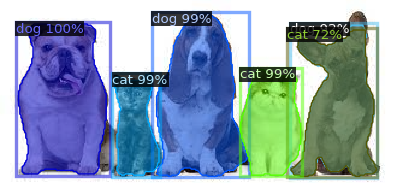

In [88]:
v = Visualizer(cat_dog[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out_1 = v.draw_instance_predictions(outputs_cat_dog["instances"].to("cpu"))
cv2_imshow(out_1.get_image()[:, :, ::-1])

In [89]:
predicted_classes = outputs_cat_dog["instances"].pred_classes

# Define the class ID you want to filter for (e.g., "cat" class)

cat_class_id = 15

# Filter instances belonging to the 'cat' class
cat_dog_instances = outputs_cat_dog["instances"][predicted_classes == cat_class_id]

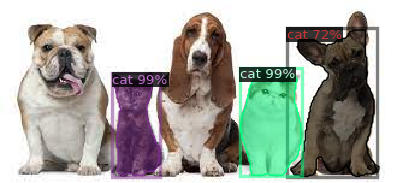

In [90]:
v = Visualizer(cat_dog[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out_1 = v.draw_instance_predictions(cat_dog_instances.to("cpu"))
cv2_imshow(out_1.get_image()[:, :, ::-1])